In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns


In [66]:
pd.set_option('display.max_columns', None)

#### Data Pre-Processing

In [5]:
# reading data into dataframe
credit= pd.read_csv("E:/_DATA SCIENCE/Projects/4. Segmentation of Credit Card Customers/CC_GENERAL.csv")

In [6]:
credit.head()

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,C10001,40.900749,0.818182,95.40,0.00,95.4,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12
1,C10002,3202.467416,0.909091,0.00,0.00,0.0,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12
2,C10003,2495.148862,1.000000,773.17,773.17,0.0,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12
3,C10004,1666.670542,0.636364,1499.00,1499.00,0.0,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,NaN,0.000000,12
4,C10005,817.714335,1.000000,16.00,16.00,0.0,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12


In [7]:
credit.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8950 entries, 0 to 8949
Data columns (total 18 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   CUST_ID                           8950 non-null   object 
 1   BALANCE                           8950 non-null   float64
 2   BALANCE_FREQUENCY                 8950 non-null   float64
 3   PURCHASES                         8950 non-null   float64
 4   ONEOFF_PURCHASES                  8950 non-null   float64
 5   INSTALLMENTS_PURCHASES            8950 non-null   float64
 6   CASH_ADVANCE                      8950 non-null   float64
 7   PURCHASES_FREQUENCY               8950 non-null   float64
 8   ONEOFF_PURCHASES_FREQUENCY        8950 non-null   float64
 9   PURCHASES_INSTALLMENTS_FREQUENCY  8950 non-null   float64
 10  CASH_ADVANCE_FREQUENCY            8950 non-null   float64
 11  CASH_ADVANCE_TRX                  8950 non-null   int64  
 12  PURCHA

In [10]:
credit.describe().T

,count,mean,std,min,25%,50%,75%,max
BALANCE,8950.0,1564.474828,2081.531879,0.000000,128.281915,873.385231,2054.140036,19043.13856
BALANCE_FREQUENCY,8950.0,0.877271,0.236904,0.000000,0.888889,1.000000,1.000000,1.00000
PURCHASES,8950.0,1003.204834,2136.634782,0.000000,39.635000,361.280000,1110.130000,49039.57000
ONEOFF_PURCHASES,8950.0,592.437371,1659.887917,0.000000,0.000000,38.000000,577.405000,40761.25000
INSTALLMENTS_PURCHASES,8950.0,411.067645,904.338115,0.000000,0.000000,89.000000,468.637500,22500.00000
CASH_ADVANCE,8950.0,978.871112,2097.163877,0.000000,0.000000,0.000000,1113.821139,47137.21176
PURCHASES_FREQUENCY,8950.0,0.490351,0.401371,0.000000,0.083333,0.500000,0.916667,1.00000
ONEOFF_PURCHASES_FREQUENCY,8950.0,0.202458,0.298336,0.000000,0.000000,0.083333,0.300000,1.00000
PURCHASES_INSTALLMENTS_FREQUENCY,8950.0,0.364437,0.397448,0.000000,0.000000,0.166667,0.750000,1.00000
CASH_ADVANCE_FREQUENCY,8950.0,0.135144,0.200121,0.000000,0.000000,0.000000,0.222222,1.50000


#### ------------------------------------------------------Missing value Treatement------------------------------------------------------

In [12]:
credit.isnull().sum()

CUST_ID                               0
BALANCE                               0
BALANCE_FREQUENCY                     0
PURCHASES                             0
ONEOFF_PURCHASES                      0
INSTALLMENTS_PURCHASES                0
CASH_ADVANCE                          0
PURCHASES_FREQUENCY                   0
ONEOFF_PURCHASES_FREQUENCY            0
PURCHASES_INSTALLMENTS_FREQUENCY      0
CASH_ADVANCE_FREQUENCY                0
CASH_ADVANCE_TRX                      0
PURCHASES_TRX                         0
CREDIT_LIMIT                          1
PAYMENTS                              0
MINIMUM_PAYMENTS                    313
PRC_FULL_PAYMENT                      0
TENURE                                0
dtype: int64

In [15]:
credit['CREDIT_LIMIT'].value_counts()

0       1000.0
1       7000.0
2       7500.0
3       7500.0
4       1200.0
         ...  
8945    1000.0
8946    1000.0
8947    1000.0
8948     500.0
8949    1200.0
Name: CREDIT_LIMIT, Length: 8950, dtype: float64

In [17]:
credit['CREDIT_LIMIT'].fillna(credit['CREDIT_LIMIT'].mean(),inplace=True)

In [22]:
credit['CREDIT_LIMIT'].isnull().any()

False

In [23]:
credit['MINIMUM_PAYMENTS'].value_counts()

299.351881     2
3.197940       1
111.691332     1
129.682608     1
872.760983     1
              ..
1227.773229    1
127.210691     1
6422.472544    1
471.940554     1
189.459157     1
Name: MINIMUM_PAYMENTS, Length: 8636, dtype: int64

In [24]:
credit['MINIMUM_PAYMENTS'].fillna(credit['MINIMUM_PAYMENTS'].median(),inplace=True)
credit['MINIMUM_PAYMENTS'].isnull().any()

False

In [25]:
credit.isnull().sum()

CUST_ID                             0
BALANCE                             0
BALANCE_FREQUENCY                   0
PURCHASES                           0
ONEOFF_PURCHASES                    0
INSTALLMENTS_PURCHASES              0
CASH_ADVANCE                        0
PURCHASES_FREQUENCY                 0
ONEOFF_PURCHASES_FREQUENCY          0
PURCHASES_INSTALLMENTS_FREQUENCY    0
CASH_ADVANCE_FREQUENCY              0
CASH_ADVANCE_TRX                    0
PURCHASES_TRX                       0
CREDIT_LIMIT                        0
PAYMENTS                            0
MINIMUM_PAYMENTS                    0
PRC_FULL_PAYMENT                    0
TENURE                              0
dtype: int64

### KPI

1. Monthly_avg_purchase and cash_advance_amount

In [26]:
credit['MONTH_AVG_PURCHASE']=credit['PURCHASES']/credit['TENURE']

In [27]:
credit.head()

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,MONTH_AVG_PURCHASE
0,C10001,40.900749,0.818182,95.40,0.00,95.4,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12,7.950000
1,C10002,3202.467416,0.909091,0.00,0.00,0.0,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12,0.000000
2,C10003,2495.148862,1.000000,773.17,773.17,0.0,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12,64.430833
3,C10004,1666.670542,0.636364,1499.00,1499.00,0.0,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,312.343947,0.000000,12,124.916667
4,C10005,817.714335,1.000000,16.00,16.00,0.0,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12,1.333333


In [28]:
credit['CASH_ADVANCE_AMT']=credit['CASH_ADVANCE']/credit['TENURE']

In [29]:
credit.head()

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,MONTH_AVG_PURCHASE,CASH_ADVANCE_AMT
0,C10001,40.900749,0.818182,95.40,0.00,95.4,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12,7.950000,0.000000
1,C10002,3202.467416,0.909091,0.00,0.00,0.0,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12,0.000000,536.912124
2,C10003,2495.148862,1.000000,773.17,773.17,0.0,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12,64.430833,0.000000
3,C10004,1666.670542,0.636364,1499.00,1499.00,0.0,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,312.343947,0.000000,12,124.916667,17.149001
4,C10005,817.714335,1.000000,16.00,16.00,0.0,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12,1.333333,0.000000


2. PURCHASE_TYPE

In [30]:
credit.ONEOFF_PURCHASES.head()

0       0.00
1       0.00
2     773.17
3    1499.00
4      16.00
Name: ONEOFF_PURCHASES, dtype: float64

In [31]:
credit.INSTALLMENTS_PURCHASES.head()

0    95.4
1     0.0
2     0.0
3     0.0
4     0.0
Name: INSTALLMENTS_PURCHASES, dtype: float64

In [68]:
def purchase_type(credit):
    if((credit.ONEOFF_PURCHASES==0)&(credit.INSTALLMENTS_PURCHASES==0)):
        return 'none'
    if((credit.ONEOFF_PURCHASES>0)&(credit.INSTALLMENTS_PURCHASES>0)):
        return 'both'
    if((credit.ONEOFF_PURCHASES==0)&(credit.INSTALLMENTS_PURCHASES>0)):
        return 'installment'
    if((credit.ONEOFF_PURCHASES>0)&(credit.INSTALLMENTS_PURCHASES==0)):
        return 'oneoff'

In [69]:
credit['PURCHASE_TYPE']=credit.apply(purchase_type,axis=1)

In [37]:
credit.PURCHASE_TYPE.value_counts()

People who do both(installment & oneoff):    2774
People who do installment only :             2260
People who do none :                         2042
People who do oneoff only :                  1874
Name: PURCHASE_TYPE, dtype: int64

In [38]:
credit.columns

Index(['CUST_ID', 'BALANCE', 'BALANCE_FREQUENCY', 'PURCHASES',
       'ONEOFF_PURCHASES', 'INSTALLMENTS_PURCHASES', 'CASH_ADVANCE',
       'PURCHASES_FREQUENCY', 'ONEOFF_PURCHASES_FREQUENCY',
       'PURCHASES_INSTALLMENTS_FREQUENCY', 'CASH_ADVANCE_FREQUENCY',
       'CASH_ADVANCE_TRX', 'PURCHASES_TRX', 'CREDIT_LIMIT', 'PAYMENTS',
       'MINIMUM_PAYMENTS', 'PRC_FULL_PAYMENT', 'TENURE', 'MONTH_AVG_PURCHASE',
       'CASH_ADVANCE_AMT', 'PURCHASE_TYPE'],
      dtype='object')

3. Average amount per purchase and cash advance transaction

In [39]:
credit.MONTH_AVG_PURCHASE.head()

0      7.950000
1      0.000000
2     64.430833
3    124.916667
4      1.333333
Name: MONTH_AVG_PURCHASE, dtype: float64

In [40]:
credit.CASH_ADVANCE_TRX.head()

0    0
1    4
2    0
3    1
4    0
Name: CASH_ADVANCE_TRX, dtype: int64

4. LIMIT_USAGE ( BALANCE/CREDIT_LIMIT)

In [41]:
credit['LIMIT_USAGE']=credit['BALANCE']/credit['CREDIT_LIMIT']

In [43]:
credit.loc[:,['BALANCE','CREDIT_LIMIT','LIMIT_USAGE']].head()

,BALANCE,CREDIT_LIMIT,LIMIT_USAGE
0,40.900749,1000.0,0.040901
1,3202.467416,7000.0,0.457495
2,2495.148862,7500.0,0.332687
3,1666.670542,7500.0,0.222223
4,817.714335,1200.0,0.681429


5. PAYMENTS TO MINIMUM PAYMENTS RATIO (PAYMENTS:MIN PAYMENTS)

In [45]:
credit.loc[:,['PAYMENTS','MINIMUM_PAYMENTS']].head()

,PAYMENTS,MINIMUM_PAYMENTS
0,201.802084,139.509787
1,4103.032597,1072.340217
2,622.066742,627.284787
3,0.000000,312.343947
4,678.334763,244.791237


In [46]:
credit['PAYMENT_MINPAY']=credit['PAYMENTS']/credit['MINIMUM_PAYMENTS']

In [49]:
credit.loc[:,['PAYMENTS','MINIMUM_PAYMENTS','PAYMENT_MINPAY']].head()

,PAYMENTS,MINIMUM_PAYMENTS,PAYMENT_MINPAY
0,201.802084,139.509787,1.446508
1,4103.032597,1072.340217,3.826241
2,622.066742,627.284787,0.991682
3,0.000000,312.343947,0.000000
4,678.334763,244.791237,2.771075


### Removing outliers

In [52]:
credit.describe().T

,count,mean,std,min,25%,50%,75%,max
BALANCE,8950.0,1564.474828,2081.531879,0.000000,128.281915,873.385231,2054.140036,19043.138560
BALANCE_FREQUENCY,8950.0,0.877271,0.236904,0.000000,0.888889,1.000000,1.000000,1.000000
PURCHASES,8950.0,1003.204834,2136.634782,0.000000,39.635000,361.280000,1110.130000,49039.570000
ONEOFF_PURCHASES,8950.0,592.437371,1659.887917,0.000000,0.000000,38.000000,577.405000,40761.250000
INSTALLMENTS_PURCHASES,8950.0,411.067645,904.338115,0.000000,0.000000,89.000000,468.637500,22500.000000
CASH_ADVANCE,8950.0,978.871112,2097.163877,0.000000,0.000000,0.000000,1113.821139,47137.211760
PURCHASES_FREQUENCY,8950.0,0.490351,0.401371,0.000000,0.083333,0.500000,0.916667,1.000000
ONEOFF_PURCHASES_FREQUENCY,8950.0,0.202458,0.298336,0.000000,0.000000,0.083333,0.300000,1.000000
PURCHASES_INSTALLMENTS_FREQUENCY,8950.0,0.364437,0.397448,0.000000,0.000000,0.166667,0.750000,1.000000
CASH_ADVANCE_FREQUENCY,8950.0,0.135144,0.200121,0.000000,0.000000,0.000000,0.222222,1.500000


In [54]:
credit.shape

(8950, 23)

In [56]:
credit.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8950 entries, 0 to 8949
Data columns (total 23 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   CUST_ID                           8950 non-null   object 
 1   BALANCE                           8950 non-null   float64
 2   BALANCE_FREQUENCY                 8950 non-null   float64
 3   PURCHASES                         8950 non-null   float64
 4   ONEOFF_PURCHASES                  8950 non-null   float64
 5   INSTALLMENTS_PURCHASES            8950 non-null   float64
 6   CASH_ADVANCE                      8950 non-null   float64
 7   PURCHASES_FREQUENCY               8950 non-null   float64
 8   ONEOFF_PURCHASES_FREQUENCY        8950 non-null   float64
 9   PURCHASES_INSTALLMENTS_FREQUENCY  8950 non-null   float64
 10  CASH_ADVANCE_FREQUENCY            8950 non-null   float64
 11  CASH_ADVANCE_TRX                  8950 non-null   int64  
 12  PURCHA

In [57]:
df=credit.drop(['CUST_ID','PURCHASE_TYPE'],axis=1).applymap(lambda x: np.log(x+1))

In [58]:
df.head()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,...,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,MONTH_AVG_PURCHASE,CASH_ADVANCE_AMT,LIMIT_USAGE,PAYMENT_MINPAY
0,3.735304,0.597837,4.568506,0.000000,4.568506,0.000000,0.154151,0.000000,0.080042,0.000000,...,1.098612,6.908755,5.312231,4.945277,0.000000,2.564949,2.191654,0.000000,0.040086,0.894662
1,8.071989,0.646627,0.000000,0.000000,0.000000,8.770896,0.000000,0.000000,0.000000,0.223144,...,0.000000,8.853808,8.319725,6.978531,0.200671,2.564949,0.000000,6.287695,0.376719,1.574068
2,7.822504,0.693147,6.651791,6.651791,0.000000,0.000000,0.693147,0.693147,0.000000,0.000000,...,2.564949,8.922792,6.434654,6.442994,0.000000,2.564949,4.180994,0.000000,0.287197,0.688979
3,7.419183,0.492477,7.313220,7.313220,0.000000,5.331694,0.080042,0.080042,0.000000,0.080042,...,0.693147,8.922792,0.000000,5.747301,0.000000,2.564949,4.835620,2.898616,0.200671,0.000000
4,6.707735,0.693147,2.833213,2.833213,0.000000,0.000000,0.080042,0.080042,0.000000,0.000000,...,0.693147,7.090910,6.521114,5.504483,0.000000,2.564949,0.847298,0.000000,0.519644,1.327360


In [62]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
BALANCE,8950.0,6.161637,2.013303,0.000000,4.861995,6.773521,7.628099,9.854515
BALANCE_FREQUENCY,8950.0,0.619940,0.148590,0.000000,0.635989,0.693147,0.693147,0.693147
PURCHASES,8950.0,4.899647,2.916872,0.000000,3.704627,5.892417,7.013133,10.800403
ONEOFF_PURCHASES,8950.0,3.204274,3.246365,0.000000,0.000000,3.663562,6.360274,10.615512
INSTALLMENTS_PURCHASES,8950.0,3.352403,3.082973,0.000000,0.000000,4.499810,6.151961,10.021315
CASH_ADVANCE,8950.0,3.319086,3.566298,0.000000,0.000000,0.000000,7.016449,10.760839
PURCHASES_FREQUENCY,8950.0,0.361268,0.277317,0.000000,0.080042,0.405465,0.650588,0.693147
ONEOFF_PURCHASES_FREQUENCY,8950.0,0.158699,0.216672,0.000000,0.000000,0.080042,0.262364,0.693147
PURCHASES_INSTALLMENTS_FREQUENCY,8950.0,0.270072,0.281852,0.000000,0.000000,0.154151,0.559616,0.693147
CASH_ADVANCE_FREQUENCY,8950.0,0.113512,0.156716,0.000000,0.000000,0.000000,0.200671,0.916291


In [70]:
df['PURCHASE_TYPE']=credit.loc[:,['PURCHASE_TYPE']]

In [71]:
df.head()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,MONTH_AVG_PURCHASE,CASH_ADVANCE_AMT,LIMIT_USAGE,PAYMENT_MINPAY,PURCHASE_TYPE
0,3.735304,0.597837,4.568506,0.000000,4.568506,0.000000,0.154151,0.000000,0.080042,0.000000,0.000000,1.098612,6.908755,5.312231,4.945277,0.000000,2.564949,2.191654,0.000000,0.040086,0.894662,installment
1,8.071989,0.646627,0.000000,0.000000,0.000000,8.770896,0.000000,0.000000,0.000000,0.223144,1.609438,0.000000,8.853808,8.319725,6.978531,0.200671,2.564949,0.000000,6.287695,0.376719,1.574068,none
2,7.822504,0.693147,6.651791,6.651791,0.000000,0.000000,0.693147,0.693147,0.000000,0.000000,0.000000,2.564949,8.922792,6.434654,6.442994,0.000000,2.564949,4.180994,0.000000,0.287197,0.688979,oneoff
3,7.419183,0.492477,7.313220,7.313220,0.000000,5.331694,0.080042,0.080042,0.000000,0.080042,0.693147,0.693147,8.922792,0.000000,5.747301,0.000000,2.564949,4.835620,2.898616,0.200671,0.000000,oneoff
4,6.707735,0.693147,2.833213,2.833213,0.000000,0.000000,0.080042,0.080042,0.000000,0.000000,0.000000,0.693147,7.090910,6.521114,5.504483,0.000000,2.564949,0.847298,0.000000,0.519644,1.327360,oneoff


In [72]:
a=pd.get_dummies(credit['PURCHASE_TYPE'])
df=df.join(a)

In [73]:
df.head()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,MONTH_AVG_PURCHASE,CASH_ADVANCE_AMT,LIMIT_USAGE,PAYMENT_MINPAY,PURCHASE_TYPE,both,installment,none,oneoff
0,3.735304,0.597837,4.568506,0.000000,4.568506,0.000000,0.154151,0.000000,0.080042,0.000000,0.000000,1.098612,6.908755,5.312231,4.945277,0.000000,2.564949,2.191654,0.000000,0.040086,0.894662,installment,0,1,0,0
1,8.071989,0.646627,0.000000,0.000000,0.000000,8.770896,0.000000,0.000000,0.000000,0.223144,1.609438,0.000000,8.853808,8.319725,6.978531,0.200671,2.564949,0.000000,6.287695,0.376719,1.574068,none,0,0,1,0
2,7.822504,0.693147,6.651791,6.651791,0.000000,0.000000,0.693147,0.693147,0.000000,0.000000,0.000000,2.564949,8.922792,6.434654,6.442994,0.000000,2.564949,4.180994,0.000000,0.287197,0.688979,oneoff,0,0,0,1
3,7.419183,0.492477,7.313220,7.313220,0.000000,5.331694,0.080042,0.080042,0.000000,0.080042,0.693147,0.693147,8.922792,0.000000,5.747301,0.000000,2.564949,4.835620,2.898616,0.200671,0.000000,oneoff,0,0,0,1
4,6.707735,0.693147,2.833213,2.833213,0.000000,0.000000,0.080042,0.080042,0.000000,0.000000,0.000000,0.693147,7.090910,6.521114,5.504483,0.000000,2.564949,0.847298,0.000000,0.519644,1.327360,oneoff,0,0,0,1


In [74]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8950 entries, 0 to 8949
Data columns (total 26 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   BALANCE                           8950 non-null   float64
 1   BALANCE_FREQUENCY                 8950 non-null   float64
 2   PURCHASES                         8950 non-null   float64
 3   ONEOFF_PURCHASES                  8950 non-null   float64
 4   INSTALLMENTS_PURCHASES            8950 non-null   float64
 5   CASH_ADVANCE                      8950 non-null   float64
 6   PURCHASES_FREQUENCY               8950 non-null   float64
 7   ONEOFF_PURCHASES_FREQUENCY        8950 non-null   float64
 8   PURCHASES_INSTALLMENTS_FREQUENCY  8950 non-null   float64
 9   CASH_ADVANCE_FREQUENCY            8950 non-null   float64
 10  CASH_ADVANCE_TRX                  8950 non-null   float64
 11  PURCHASES_TRX                     8950 non-null   float64
 12  CREDIT

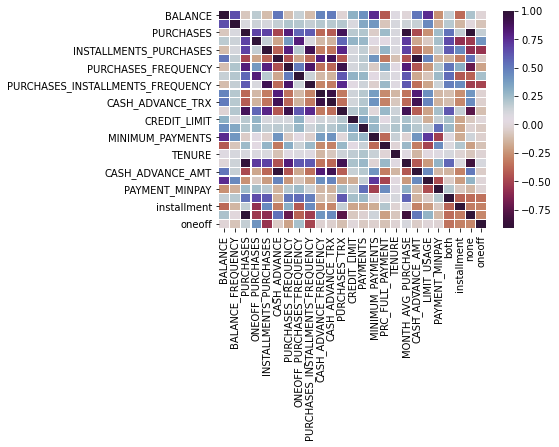

In [101]:
sns.heatmap(df.corr(),linewidths=0.1,cmap="twilight_shifted_r")

In [107]:
# Average payment_minpayment ratio for each purchse type.
x=credit.groupby('PURCHASE_TYPE').apply(lambda x: np.mean(x['PAYMENT_MINPAY']))
type(x)
x.values

array([ 7.23698216, 13.2590037 , 10.08745106,  5.57108156])

(array([2260.,    0.,    0., 2042.,    0.,    0., 1874.,    0.,    0.,
        2774.]),
 array([0. , 0.3, 0.6, 0.9, 1.2, 1.5, 1.8, 2.1, 2.4, 2.7, 3. ]),
 <a list of 10 Patch objects>)

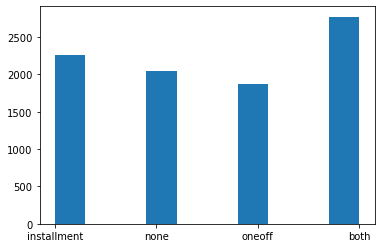

In [113]:
plt.hist(df.PURCHASE_TYPE)

In [114]:
import pandas_profiling

In [115]:
pandas_profiling.ProfileReport(df)

### Model Building


## cr_dummy=df

In [215]:
df.head()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,MONTH_AVG_PURCHASE,CASH_ADVANCE_AMT,LIMIT_USAGE,PAYMENT_MINPAY,PURCHASE_TYPE,both,installment,none,oneoff
0,3.735304,0.597837,4.568506,0.000000,4.568506,0.000000,0.154151,0.000000,0.080042,0.000000,0.000000,1.098612,6.908755,5.312231,4.945277,0.000000,2.564949,2.191654,0.000000,0.040086,0.894662,installment,0,1,0,0
1,8.071989,0.646627,0.000000,0.000000,0.000000,8.770896,0.000000,0.000000,0.000000,0.223144,1.609438,0.000000,8.853808,8.319725,6.978531,0.200671,2.564949,0.000000,6.287695,0.376719,1.574068,none,0,0,1,0
2,7.822504,0.693147,6.651791,6.651791,0.000000,0.000000,0.693147,0.693147,0.000000,0.000000,0.000000,2.564949,8.922792,6.434654,6.442994,0.000000,2.564949,4.180994,0.000000,0.287197,0.688979,oneoff,0,0,0,1
3,7.419183,0.492477,7.313220,7.313220,0.000000,5.331694,0.080042,0.080042,0.000000,0.080042,0.693147,0.693147,8.922792,0.000000,5.747301,0.000000,2.564949,4.835620,2.898616,0.200671,0.000000,oneoff,0,0,0,1
4,6.707735,0.693147,2.833213,2.833213,0.000000,0.000000,0.080042,0.080042,0.000000,0.000000,0.000000,0.693147,7.090910,6.521114,5.504483,0.000000,2.564949,0.847298,0.000000,0.519644,1.327360,oneoff,0,0,0,1


In [216]:
l=['PURCHASE_TYPE']

In [217]:
df=df.drop(l,axis=1)
df.isnull().sum()

BALANCE                             0
BALANCE_FREQUENCY                   0
PURCHASES                           0
ONEOFF_PURCHASES                    0
INSTALLMENTS_PURCHASES              0
CASH_ADVANCE                        0
PURCHASES_FREQUENCY                 0
ONEOFF_PURCHASES_FREQUENCY          0
PURCHASES_INSTALLMENTS_FREQUENCY    0
CASH_ADVANCE_FREQUENCY              0
CASH_ADVANCE_TRX                    0
PURCHASES_TRX                       0
CREDIT_LIMIT                        0
PAYMENTS                            0
MINIMUM_PAYMENTS                    0
PRC_FULL_PAYMENT                    0
TENURE                              0
MONTH_AVG_PURCHASE                  0
CASH_ADVANCE_AMT                    0
LIMIT_USAGE                         0
PAYMENT_MINPAY                      0
both                                0
installment                         0
none                                0
oneoff                              0
dtype: int64

In [218]:
df.head()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,MONTH_AVG_PURCHASE,CASH_ADVANCE_AMT,LIMIT_USAGE,PAYMENT_MINPAY,both,installment,none,oneoff
0,3.735304,0.597837,4.568506,0.000000,4.568506,0.000000,0.154151,0.000000,0.080042,0.000000,0.000000,1.098612,6.908755,5.312231,4.945277,0.000000,2.564949,2.191654,0.000000,0.040086,0.894662,0,1,0,0
1,8.071989,0.646627,0.000000,0.000000,0.000000,8.770896,0.000000,0.000000,0.000000,0.223144,1.609438,0.000000,8.853808,8.319725,6.978531,0.200671,2.564949,0.000000,6.287695,0.376719,1.574068,0,0,1,0
2,7.822504,0.693147,6.651791,6.651791,0.000000,0.000000,0.693147,0.693147,0.000000,0.000000,0.000000,2.564949,8.922792,6.434654,6.442994,0.000000,2.564949,4.180994,0.000000,0.287197,0.688979,0,0,0,1
3,7.419183,0.492477,7.313220,7.313220,0.000000,5.331694,0.080042,0.080042,0.000000,0.080042,0.693147,0.693147,8.922792,0.000000,5.747301,0.000000,2.564949,4.835620,2.898616,0.200671,0.000000,0,0,0,1
4,6.707735,0.693147,2.833213,2.833213,0.000000,0.000000,0.080042,0.080042,0.000000,0.000000,0.000000,0.693147,7.090910,6.521114,5.504483,0.000000,2.564949,0.847298,0.000000,0.519644,1.327360,0,0,0,1


In [219]:
df.describe()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,MONTH_AVG_PURCHASE,CASH_ADVANCE_AMT,LIMIT_USAGE,PAYMENT_MINPAY,both,installment,none,oneoff
count,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000
mean,6.161637,0.619940,4.899647,3.204274,3.352403,3.319086,0.361268,0.158699,0.270072,0.113512,0.817570,1.894731,8.094870,6.624540,5.916079,0.117730,2.519680,3.050877,2.163970,0.296081,1.357600,0.309944,0.252514,0.228156,0.209385
std,2.013303,0.148590,2.916872,3.246365,3.082973,3.566298,0.277317,0.216672,0.281852,0.156716,1.009316,1.373856,0.819635,1.591763,1.169929,0.211617,0.130367,2.002823,2.429741,0.250303,0.940149,0.462496,0.434479,0.419667,0.406893
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.931826,0.000000,0.018982,0.000000,1.945910,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,4.861995,0.635989,3.704627,0.000000,0.000000,0.000000,0.080042,0.000000,0.000000,0.000000,0.000000,0.693147,7.378384,5.951361,5.146667,0.000000,2.564949,1.481458,0.000000,0.040656,0.648817,0.000000,0.000000,0.000000,0.000000
50%,6.773521,0.693147,5.892417,3.663562,4.499810,0.000000,0.405465,0.080042,0.154151,0.000000,0.000000,2.079442,8.006701,6.754489,5.747301,0.000000,2.564949,3.494587,0.000000,0.264455,1.109459,0.000000,0.000000,0.000000,0.000000
75%,7.628099,0.693147,7.013133,6.360274,6.151961,7.016449,0.650588,0.262364,0.559616,0.200671,1.609438,2.890372,8.779711,7.550732,6.671670,0.133531,2.564949,4.587295,4.606022,0.540911,1.953415,1.000000,1.000000,0.000000,0.000000
max,9.854515,0.693147,10.800403,10.615512,10.021315,10.760839,0.693147,0.693147,0.693147,0.916291,4.820282,5.883322,10.308986,10.834125,11.243832,0.693147,2.564949,8.315721,8.276166,2.827902,8.830767,1.000000,1.000000,1.000000,1.000000


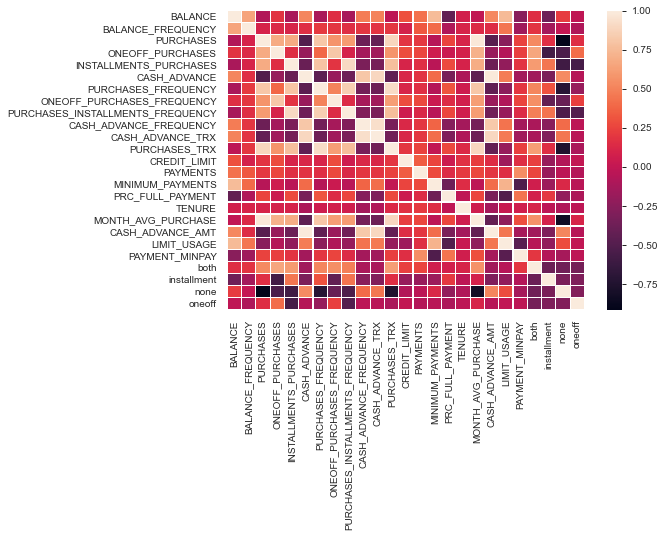

In [220]:
sns.heatmap(df.corr(),linewidths=0.1)

 Standardrizing data

   > To put data on the same scale



In [221]:
from sklearn.preprocessing import  StandardScaler
sc=StandardScaler()
cr_scaled=sc.fit_transform(df)

## PCA

In [143]:
from sklearn.decomposition import PCA

In [222]:
var_ratio={}
for n in range(4,15):
    pc=PCA(n_components=n)
    cr_pca=pc.fit(cr_scaled)
    var_ratio[n]=sum(cr_pca.explained_variance_ratio_)

In [223]:
pc=PCA(n_components=5)

In [224]:
p=pc.fit(cr_scaled)

In [225]:
cr_scaled.shape

(8950, 25)

In [226]:
p.explained_variance_

array([8.48546928, 4.78610397, 2.71450396, 2.07609462, 1.36774557])

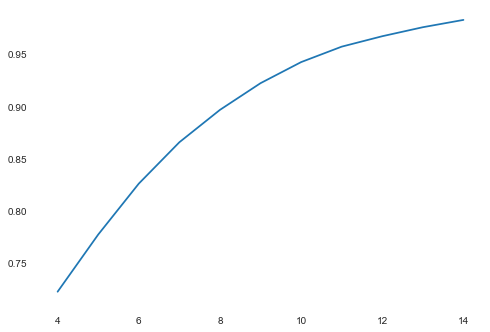

In [227]:
pd.Series(var_ratio).plot()

In [152]:
var_ratio

{4: 0.7321020054145702,
 5: 0.7948808973221887,
 6: 0.843021864941283,
 7: 0.8777748098820188,
 8: 0.9051933378716642,
 9: 0.9273382950083863,
 10: 0.9448252444407802,
 11: 0.9598908535565802,
 12: 0.9692545745503993,
 13: 0.9776263710502836,
 14: 0.983900323656961}

In [228]:
df_pca_final=PCA(n_components=7)
df2=df_pca_final.fit_transform(cr_scaled)

In [229]:
df2

array([[ 2.29623764e-01, -3.34044628e+00, -8.98024233e-01, ...,
        -1.52476060e-01, -2.20526441e-01, -3.53320109e-02],
       [-4.50437637e+00,  7.52528419e-01, -1.79804606e-01, ...,
        -1.38704683e+00, -4.56936064e-01, -1.78520213e-01],
       [ 1.43612539e+00,  1.14917618e+00,  2.74317237e+00, ...,
        -4.28808592e-01, -9.13095548e-01, -1.43424595e-01],
       ...,
       [ 1.46783845e+00, -3.68231360e+00, -1.72226791e+00, ...,
         3.04194883e+00,  1.04978236e+00,  2.06709483e+00],
       [-3.23816008e+00, -3.99746666e+00,  3.38971137e-01, ...,
         2.33845771e+00,  2.90187321e+00,  2.61453789e+00],
       [ 5.37382552e-02,  2.00897697e-03,  2.53479204e+00, ...,
         5.01265972e+00,  1.06272443e+00,  1.80284253e+00]])

In [230]:
df2_dframe=pd.DataFrame(df2)

In [231]:
col=df.columns

In [232]:
col

Index(['BALANCE', 'BALANCE_FREQUENCY', 'PURCHASES', 'ONEOFF_PURCHASES',
       'INSTALLMENTS_PURCHASES', 'CASH_ADVANCE', 'PURCHASES_FREQUENCY',
       'ONEOFF_PURCHASES_FREQUENCY', 'PURCHASES_INSTALLMENTS_FREQUENCY',
       'CASH_ADVANCE_FREQUENCY', 'CASH_ADVANCE_TRX', 'PURCHASES_TRX',
       'CREDIT_LIMIT', 'PAYMENTS', 'MINIMUM_PAYMENTS', 'PRC_FULL_PAYMENT',
       'TENURE', 'MONTH_AVG_PURCHASE', 'CASH_ADVANCE_AMT', 'LIMIT_USAGE',
       'PAYMENT_MINPAY', 'both', 'installment', 'none', 'oneoff'],
      dtype='object')

In [233]:
pd.DataFrame(df_pca_final.components_.T, columns=['PC_' +str(i) for i in range(7)],index=col)

,PC_0,PC_1,PC_2,PC_3,PC_4,PC_5,PC_6
BALANCE,-0.116214,0.376419,-0.070123,-0.141469,-0.156325,-0.065391,0.108651
BALANCE_FREQUENCY,-0.002630,0.270362,-0.139906,-0.132010,-0.221247,-0.080593,0.449545
PURCHASES,0.306753,0.130478,0.046341,-0.082618,0.177033,-0.154796,-0.034495
ONEOFF_PURCHASES,0.179249,0.246057,0.369035,-0.068650,0.069161,0.141937,-0.019907
INSTALLMENTS_PURCHASES,0.264643,0.070277,-0.336971,0.090704,0.028672,0.096817,-0.085643
CASH_ADVANCE,-0.252063,0.214469,-0.056325,0.194905,0.221370,-0.019086,-0.063666
PURCHASES_FREQUENCY,0.295865,0.107384,-0.166240,-0.002053,0.122943,-0.018347,0.063558
ONEOFF_PURCHASES_FREQUENCY,0.177584,0.229546,0.289201,-0.000793,0.016010,0.142350,0.065855
PURCHASES_INSTALLMENTS_FREQUENCY,0.248470,0.058157,-0.357817,0.065700,0.051035,0.061146,-0.010179
CASH_ADVANCE_FREQUENCY,-0.215605,0.223936,-0.061650,0.191940,0.308275,-0.062022,-0.038122


## Clustering

In [234]:
from sklearn.cluster import KMeans

In [235]:
distortions=[]
K=range(1,10)
for k in K:
    kmean_model=KMeans(n_clusters=k)
    kmean_model.fit(df2)
    distortions.append(kmean_model.inertia_)

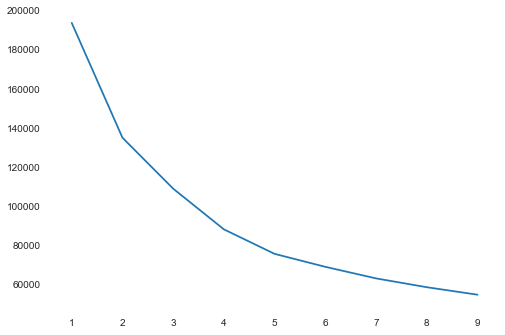

In [236]:
plt.plot(K,distortions)

### 4 clusters

In [237]:
from sklearn.cluster import KMeans
km_4=KMeans(n_clusters=4,random_state=123)
km_4.fit(df2)
km_4.labels_

array([2, 0, 3, ..., 2, 0, 3])

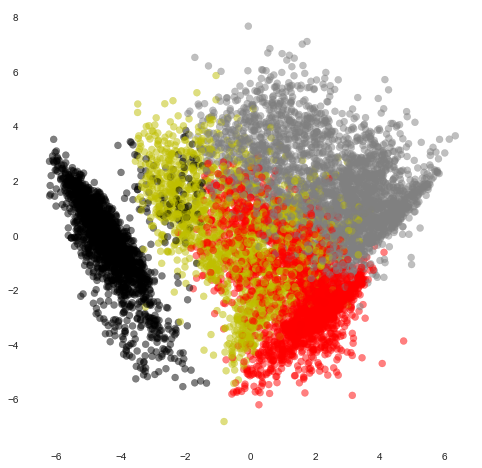

In [238]:
color_map={0:'black',1:'grey',2:'red',3:'y'}
km_4.fit(df2)
label_color=[color_map[l] for l in km_4.labels_]
plt.figure(figsize=(8,8))
plt.scatter(df2[:,0],df2[:,1],c=label_color,cmap='Spectral',alpha=0.5)

In [239]:
df.dtypes

BALANCE                             float64
BALANCE_FREQUENCY                   float64
PURCHASES                           float64
ONEOFF_PURCHASES                    float64
INSTALLMENTS_PURCHASES              float64
CASH_ADVANCE                        float64
PURCHASES_FREQUENCY                 float64
ONEOFF_PURCHASES_FREQUENCY          float64
PURCHASES_INSTALLMENTS_FREQUENCY    float64
CASH_ADVANCE_FREQUENCY              float64
CASH_ADVANCE_TRX                    float64
PURCHASES_TRX                       float64
CREDIT_LIMIT                        float64
PAYMENTS                            float64
MINIMUM_PAYMENTS                    float64
PRC_FULL_PAYMENT                    float64
TENURE                              float64
MONTH_AVG_PURCHASE                  float64
CASH_ADVANCE_AMT                    float64
LIMIT_USAGE                         float64
PAYMENT_MINPAY                      float64
both                                  uint8
installment                     

##### Key performace variable selection .

In [240]:
#here i am dropping varibales which are used in derving new KPI
col_kpi=['PURCHASES_TRX','MONTH_AVG_PURCHASE','CASH_ADVANCE_AMT','LIMIT_USAGE',
         'CASH_ADVANCE_TRX','PAYMENT_MINPAY','both','installment',
         'none','oneoff','CREDIT_LIMIT']

In [243]:
# Conactenating labels found through Kmeans with data 
cluster_df_4=pd.concat([df[col_kpi],pd.Series(km_4.labels_,name='Cluster_4')],axis=1)

In [244]:
cluster_df_4.head()

,PURCHASES_TRX,MONTH_AVG_PURCHASE,CASH_ADVANCE_AMT,LIMIT_USAGE,CASH_ADVANCE_TRX,PAYMENT_MINPAY,both,installment,none,oneoff,CREDIT_LIMIT,Cluster_4
0,1.098612,2.191654,0.000000,0.040086,0.000000,0.894662,0,1,0,0,6.908755,2
1,0.000000,0.000000,6.287695,0.376719,1.609438,1.574068,0,0,1,0,8.853808,0
2,2.564949,4.180994,0.000000,0.287197,0.000000,0.688979,0,0,0,1,8.922792,3
3,0.693147,4.835620,2.898616,0.200671,0.693147,0.000000,0,0,0,1,8.922792,3
4,0.693147,0.847298,0.000000,0.519644,0.000000,1.327360,0,0,0,1,7.090910,3


In [245]:
# Mean value gives a good indication of the distribution of data. So we are finding mean value for each variable for each cluster
cluster_4=cluster_df_4.groupby('Cluster_4').apply(lambda x: x[col_kpi].mean()).T
cluster_4

Cluster_4,0,1,2,3
PURCHASES_TRX,0.064796,3.205131,2.294070,1.622514
MONTH_AVG_PURCHASE,0.101777,4.817599,3.382941,3.489947
CASH_ADVANCE_AMT,4.514922,1.709337,0.688067,1.871906
LIMIT_USAGE,0.431680,0.286615,0.182543,0.288801
CASH_ADVANCE_TRX,1.687225,0.679530,0.228492,0.717171
PAYMENT_MINPAY,1.133922,1.647298,1.253712,1.318070
both,0.001858,0.991525,0.032794,0.003231
installment,0.039480,0.008106,0.967206,0.000000
none,0.948444,0.000000,0.000000,0.000000
oneoff,0.010218,0.000368,0.000000,0.996769


In [249]:
# Percentage of each cluster in the total customer base
per=pd.Series((s.values.astype('float')/ cluster_df_4.shape[0])*100,name='Percentage')
print("Cluster_4 ",'\n')
print(pd.concat([pd.Series(s.values,name='Size'),per],axis=1),'\n')

Cluster_4  

   Size  Percentage
0  2153   24.055866
1  2714   30.324022
2  2226   24.871508
3  1857   20.748603 



### 5 clusters

In [193]:
km_5=KMeans(n_clusters=5,random_state=112)
km_5.fit(df2)

KMeans(n_clusters=5, random_state=112)

In [261]:
km_5.cluster_centers_

array([[ 0.8968537 ,  3.21252163, -1.58362016, -0.35573846,  0.5665641 ,
         1.16058255, -0.46990133],
       [-4.79817452, -0.03352097, -0.65066227,  1.08396049, -0.34486244,
        -0.33145241,  0.16397144],
       [ 3.36409057,  1.30409056, -0.08919865,  1.23915311, -0.96740724,
        -0.11783156,  0.03192412],
       [ 1.49796005, -2.90151684, -1.51214398, -0.9736723 ,  0.52317083,
        -0.09796185, -0.01930513],
       [-0.37993603,  0.27216365,  3.35226278, -1.18379652,  0.48915529,
        -0.01598591,  0.05678822]])

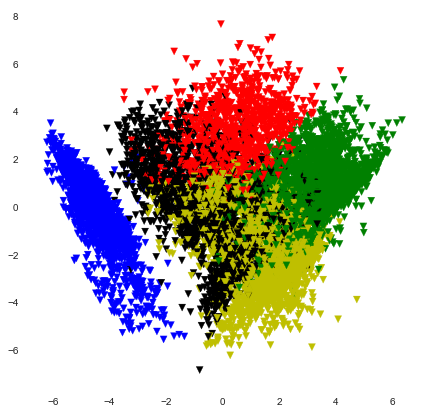

In [260]:
color_map={0:'r',1:'b',2:'g',3:'y',4:'k'}
label_color=[color_map[l] for l in km_5.labels_]
plt.figure(figsize=(7,7))
plt.scatter(df2[:,0],df2[:,1],c=label_color,marker='v')

In [250]:
cluster_df_5=pd.concat([df[col_kpi],pd.Series(km_5.labels_,name='Cluster_5')],axis=1)

In [251]:
# Finding Mean of features for each cluster
cluster_df_5.groupby('Cluster_5').apply(lambda x: x[col_kpi].mean()).T

Cluster_5,0,1,2,3,4
PURCHASES_TRX,2.993967,0.004113,3.199530,2.273984,1.611682
MONTH_AVG_PURCHASE,4.479456,0.004042,4.826941,3.354627,3.461405
CASH_ADVANCE_AMT,4.932071,4.475284,0.261329,0.596046,1.899195
LIMIT_USAGE,0.458717,0.427717,0.203258,0.181459,0.290939
CASH_ADVANCE_TRX,2.017170,1.654198,0.080665,0.192420,0.732032
PAYMENT_MINPAY,1.159291,1.138800,1.822533,1.269450,1.322128
both,0.852376,0.000000,1.000000,0.000473,0.000000
installment,0.141557,0.004388,0.000000,0.999527,0.000000
none,0.000000,0.995612,0.000000,0.000000,0.000000
oneoff,0.006067,0.000000,0.000000,0.000000,1.000000


In [253]:
C=cluster_df_5.groupby('Cluster_5').apply(lambda x: x['Cluster_5'].value_counts())

# Percentage of each cluster in the total customer base
per=pd.Series((C.values.astype('float')/ cluster_df_5.shape[0])*100,name='Percentage')
print("Cluster_5 ",'\n')
print(pd.concat([pd.Series(C.values,name='Size'),per],axis=1),'\n')

Cluster_5  

   Size  Percentage
0   989   11.050279
1  2051   22.916201
2  1930   21.564246
3  2112   23.597765
4  1868   20.871508 



## Performance metrics for Kmeans

In [265]:
from sklearn.metrics import silhouette_score

In [267]:
score={}
score_c={}
for n in range(3,10):
    km_score=KMeans(n_clusters=n)
    km_score.fit(df2)
    score[n]=silhouette_score(df2,km_score.labels_)

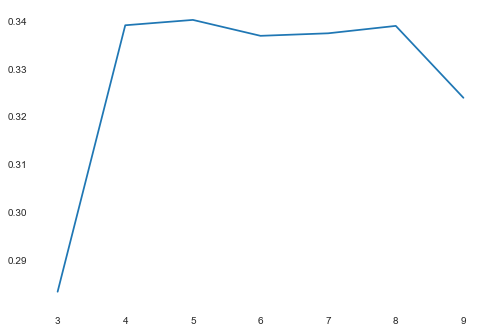

In [268]:
pd.Series(score).plot()

##### So by the elbow curve as well as by the performance matrix we can clearly see that no. of cluster must be 4

| Cluster 0      |   21%       | 
|:----------:    |:----------: |
| Cluster 1      |   23%       |
| Cluster 2      |   31%       |
| Cluster 3      |   25%       |



##### Cluster 0 
customers are doing maximum One_Off transactions and least payment ratio and credit_score on lower side 

##### Cluster 1 
is taking maximum advance_cash and is paying comparatively less minimum payment and poor credit_score & doing no purchase transaction.

##### Cluster 2 
is the group of customers who have highest Monthly_avg purchases and doing both installment as well as one_off purchases, have comparatively good credit score.

##### Cluster 3 
customers have maximum credit score and are paying dues and are doing maximum installment purchases.